In [1]:
colab_run = False
if colab_run:
    !pip -q install git+https://github.com/adalca/pystrum.git
    !pip -q install git+https://github.com/adalca/neurite.git
    !pip -q install git+https://github.com/voxelmorph/voxelmorph.git

In [2]:
model_loc = 'Models/'
csv_loc = 'CSV/'

In [3]:
# imports
import os, sys

# third party imports
import numpy as np
import tqdm
import pandas as pd
import tensorflow as tf
import voxelmorph as vxm
import neurite as ne
import matplotlib.pyplot as plt
from tqdm.keras import TqdmCallback

2023-09-22 15:24:11.278284: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX512F FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-09-22 15:24:12.280471: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [4]:

## As per the tensorflow error #60309, advice by tgoMota on github, making verbose = 2

verbose = 2

In [5]:
# Conform test data.
def conform(x, in_shape = (256,) * 2):
    '''Resize and normalize image.'''
    x = np.float32(x)
    x = ne.utils.minmax_norm(x)
    x = ne.utils.zoom(x, zoom_factor=[o / i for o, i in zip(in_shape, x.shape)])
    return np.expand_dims(x, axis=(0, -1))


In [6]:
def plot_history(hist, loss_name='loss'):
    # Simple function to plot training history.
    plt.figure()
    plt.plot(hist.epoch, hist.history[loss_name], '.-')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.show()

In [7]:
def vxm_data_generator_hybrid(x_data_real, x_data_synth, label_to_image, alpha_real=0.9, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """    
    # preliminary sizing
    vol_shape = x_data_real.shape[1:] # extract data shape
    ndims = len(vol_shape)

    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])

    batch_size_real = int(alpha_real*batch_size)
    batch_size_synth = batch_size - batch_size_real


    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1_real = np.random.randint(0, x_data_real.shape[0], size=batch_size_real)
        moving_images_real = x_data_real[idx1_real, ..., np.newaxis]
        idx2_real = np.random.randint(0, x_data_real.shape[0], size=batch_size_real)
        fixed_images_real = x_data_real[idx2_real, ..., np.newaxis]



        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1_synth = np.random.randint(0, x_data_synth.shape[0], size=batch_size_synth)
        moving_images_synth = x_data_synth[idx1_synth, ..., np.newaxis]
        idx2_synth = np.random.randint(0, x_data_synth.shape[0], size=batch_size_synth)
        fixed_images_synth = x_data_synth[idx2_synth, ..., np.newaxis]

        moving_images = np.concatenate([moving_images_real, label_to_image(moving_images_synth)], axis=0)
        fixed_images = np.concatenate([fixed_images_real, label_to_image(fixed_images_synth)], axis=0)

        inputs = [moving_images, fixed_images]

        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

In [8]:
def vxm_data_generator_real(x_data, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """

    # preliminary sizing
    vol_shape = x_data.shape[1:] # extract data shape
    ndims = len(vol_shape)
    
    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])
    
    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1 = np.random.randint(0, x_data.shape[0], size=batch_size)
        moving_images = x_data[idx1, ..., np.newaxis]
        idx2 = np.random.randint(0, x_data.shape[0], size=batch_size)
        fixed_images = x_data[idx2, ..., np.newaxis]
        inputs = [moving_images, fixed_images]
        
        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

def vxm_data_generator_synth(x_data, label_to_image, batch_size=32):
    """
    Generator that takes in data of size [N, H, W], and yields data for
    our custom vxm model. Note that we need to provide numpy data for each
    input, and each output.

    inputs:  moving [bs, H, W, 1], fixed image [bs, H, W, 1]
    outputs: moved image [bs, H, W, 1], zero-gradient [bs, H, W, 2]
    """

    # preliminary sizing
    vol_shape = x_data.shape[1:] # extract data shape
    ndims = len(vol_shape)
    
    # prepare a zero array the size of the deformation
    # we'll explain this below
    zero_phi = np.zeros([batch_size, *vol_shape, ndims])
    
    while True:
        # prepare inputs:
        # images need to be of the size [batch_size, H, W, 1]
        idx1 = np.random.randint(0, x_data.shape[0], size=batch_size)
        moving_images = label_to_image(x_data[idx1, ..., np.newaxis])
        idx2 = np.random.randint(0, x_data.shape[0], size=batch_size)
        fixed_images = label_to_image(x_data[idx2, ..., np.newaxis])
        inputs = [moving_images, fixed_images]
        
        # prepare outputs (the 'true' moved image):
        # of course, we don't have this, but we know we want to compare 
        # the resulting moved image with the fixed image. 
        # we also wish to penalize the deformation field. 
        outputs = [fixed_images, zero_phi]
        
        yield (inputs, outputs)

In [9]:
class SynthLabels():
    def __init__(self, num_label=16, num_maps=250):
        # Input shapes.
        self.in_shape = (256,) * 2
        self.num_dim = len(self.in_shape)
        self.num_label = num_label
        self.num_maps = num_maps
        gen_arg = dict(
            in_shape=self.in_shape,
            in_label_list=np.arange(16),
            warp_std=3,
            warp_res=(8, 16, 32),
        )
        self.gen_model = ne.models.labels_to_image(**gen_arg, id=1)

    def label_maps(self):
        # Shape generation.
        self.label_maps = []
        self.label_maps = np.zeros((self.num_maps, 256, 256))
        for i in tqdm.tqdm(range(self.num_maps)):
            # Draw image and warp.
            im = ne.utils.augment.draw_perlin(
                out_shape=(*self.in_shape, self.num_label),
                scales=(32, 64), max_std=1,
            )
            warp = ne.utils.augment.draw_perlin(

                out_shape=(*self.in_shape, self.num_label, self.num_dim),
                scales=(16, 32, 64), max_std=16,
            )
            # Transform and create label map.
            im = vxm.utils.transform(im, warp)
            lab = tf.argmax(im, axis=-1)
            self.label_maps[i] = np.uint8(lab)
        return self.label_maps
    
    
    def label_to_image(self, sample):
        return self.gen_model.predict(sample, verbose=verbose)[0]

2023-09-22 15:24:16.636991: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 30521 MB memory:  -> device: 0, name: Tesla V100-PCIE-32GB, pci bus id: 0000:3b:00.0, compute capability: 7.0
2023-09-22 15:24:16.637919: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:1 with 14314 MB memory:  -> device: 1, name: Tesla V100-PCIE-16GB, pci bus id: 0000:af:00.0, compute capability: 7.0


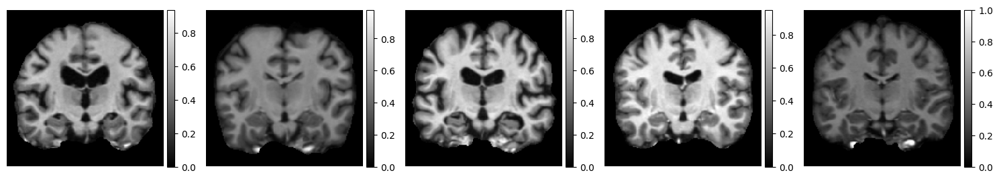

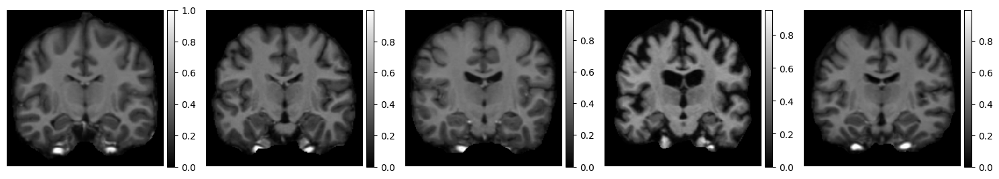

In [10]:
#Loading the dataset
images = ne.py.data.load_dataset('2D-OASIS-TUTORIAL')
conformed_images = [conform(img) for img in images]
#label_maps_real = [(img*15).astype('int').reshape(256, 256) for img in conformed_images]
label_maps_real = [img.reshape(256, 256) for img in conformed_images]


# Visualizing the dataset.
num_row = 2
per_row = 5
for i in range(0, num_row * per_row, per_row):
    ne.plot.slices(label_maps_real[i:i + per_row], cmaps=['gray'], do_colorbars=True)

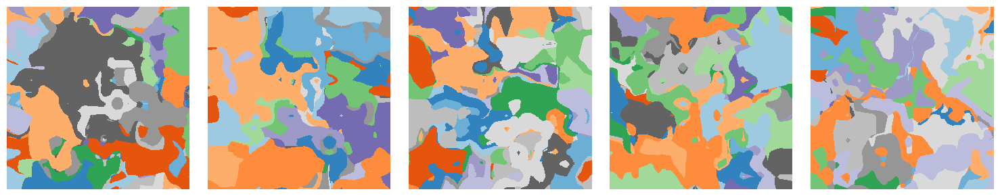

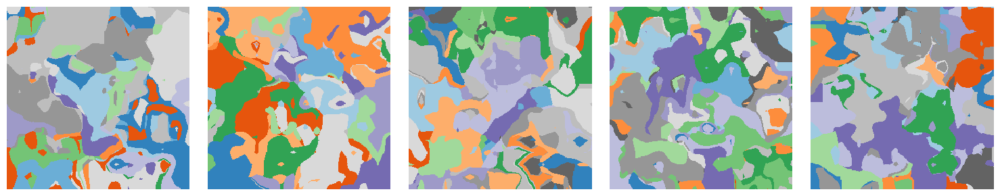

In [11]:
if os.path.exists('Synthetic_data.npy'):
    SynthIm = SynthLabels()
    label_maps_synth = np.load('Synthetic_data.npy')
    SynthIm.label_maps = label_maps_synth
else:
    SynthIm = SynthLabels()
    label_maps_synth = SynthIm.label_maps()
    np.save('Synthetic_data.npy', label_maps_synth)

# Visualize shapes.
num_row = 2
per_row = 5
for i in range(0, num_row * per_row, per_row):
    ne.plot.slices(list(label_maps_synth[i:i + per_row]), cmaps=['tab20c'])

In [12]:
class VxmTest():
    def __init__(self, ndim = 2, unet_input_features = 2):
        self.ndim = ndim
        self.unet_input_features = unet_input_features
    #CNN model
        # configure unet input shape (concatenation of moving and fixed images)
        self.vol_shape = real_train.shape[1:]
        # configure unet features 
        self.nb_features = [
            [32, 32, 32, 32],         # encoder features
            [32, 32, 32, 32, 32, 16]  # decoder features
        ]
        
        
    def CNNvxm(self, train_gen=None, val_generator=None):
        self.vxm_model = vxm.networks.VxmDense(self.vol_shape, nb_unet_features=None, int_steps=0)
        self.losses = ['mse', vxm.losses.Grad('l2').loss]
        self.loss_weights = [1, 0.01]
        self.vxm_model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=1e-4), loss=self.losses, loss_weights=self.loss_weights)
        

        self.train_generator = train_gen
        self.val_generator = val_generator

        self.in_sample, self.out_sample = next(self.train_generator)
        def Visual():
            # visualize
            images = [img[0, :, :, 0] for img in self.in_sample + self.out_sample]
            titles = ['moving', 'fixed', 'moved ground-truth (fixed)', 'zeros']
            ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True);
        Visual()
        
    def train(self, total_epo, steps_per_epoch=100):

        # self.cp_callback = ModelCheckpoint(filepath=path, save_weights_only=False, verbose=1)
        # self.callbacks=[cp_callback]
        self.hist = self.vxm_model.fit(self.train_generator, epochs=total_epo,
                                       steps_per_epoch=100, verbose=verbose,
                                       callbacks=[TqdmCallback(verbose=verbose)],
                                       validation_data=self.val_generator,
                                       validation_steps = 100);
        plot_history(self.hist)
        
    def RegPred(self, val_input):
        self.val_pred = self.vxm_model.predict(val_input)
        #visualise
        def Visual():
            images = [img[0, :, :, 0] for img in val_input + self.val_pred] 
            titles = ['moving', 'fixed', 'moved', 'flow']
            ne.plot.slices(images, titles=titles, cmaps=['gray'], do_colorbars=True);
        Visual()
        return self.val_pred

In [13]:
#Fixing data + spliting

#conversion of labels in range of [0,1]
label_maps_real = np.array(label_maps_real)
label_maps_synth = np.array(label_maps_synth)
#label_maps_real = label_maps_real.astype('float')/15
#label_maps_synth = label_maps_synth.astype('float')/15
#label_maps_hy = np.zeros((250, 256, 256))
#label_maps_hy[::2] = [i for i in label_maps_real[:125, ...]]
#label_maps_hy[1::2] = [i for i in label_maps_synth[:125, ...]]
#label_maps_hy = np.array(label_maps_hy)

#data split 
Data_split_train = 250
real_train = label_maps_real[:250, ...]
# few_shot_train = label_maps_real[:50, ...]
test_val_no = 82
real_val = label_maps_real[250:332, ...]
real_test = label_maps_real[-82:, ...]

In [14]:
# if colab_run:
#     train_no = 100
#     batch_size = 8
# else:
#     train_no = 2000
#     batch_size = 32

In [15]:
train_no = 1000/home/saumya/2023-09-21 17-12-52.mkv
/home/saumya/2023-09-21 18-09-06.mkv
# no_of_rounds = 2
batch_size = 16
alpha_real = 0.9

In [16]:
# create the few shot data generator
# few_generator = vxm_data_generator_real(real_train, batch_size = 8)
# few_input, _ = next(few_generator)

# create the training data generator
train_generator = vxm_data_generator_real(real_train, batch_size = batch_size)
train_input, _ = next(train_generator)

# create the validation data generator
val_generator = vxm_data_generator_real(real_val, batch_size = batch_size)
val_input, _ = next(val_generator)

# create synthetic data generator
synth_generator = vxm_data_generator_synth(label_maps_synth, SynthIm.label_to_image, batch_size=batch_size)
synth_input, _ = next(synth_generator)

#example of the hybrid data generator
hybrid_generator = vxm_data_generator_hybrid(real_train, label_maps_synth, SynthIm.label_to_image, alpha_real=alpha_real, batch_size=batch_size)
hybrid_input, _ = next(hybrid_generator)

2023-09-22 15:24:37.083312: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8600


1/1 - 5s - 5s/epoch - 5s/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 68ms/epoch - 68ms/step
1/1 - 0s - 55ms/epoch - 55ms/step


In [17]:
def plot_csv(filename):
    df = pd.read_csv(filename)
    nu = df.to_numpy()
    fh = nu.size
    plt.figure()
    plt.plot(range(1,nu.size+1), nu, '.-')
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.show()

In [18]:
#  from tensorflow.keras.callbacks import ModelCheckpoint

In [19]:
# Synth = VxmTest()
# Synth.CNNvxm(train_gen=synth_generator, val_generator=val_generator)
# Synth.train(total_epo=train_no)
# Synth.vxm_model.save_weights(model_loc+'Synth_pure.h5')
# b = Synth.hist.history['loss']
# a = Synth.hist.history['val_loss']
# df = pd.DataFrame(b)
# df1= pd.DataFrame(a)
# df.to_csv(csv_loc+'Synth_pure_loss.csv', index=False, header=False)
# df1.to_csv(csv_loc+'Synth_loss_val.csv', index=False, header=False)
# # for i in range(no_of_rounds-1):
# #     Synth.vxm_model.load_weights(model_loc+'Synth_pure.h5')
# #     Synth.train(total_epo=train_no)
# #     Synth.vxm_model.save_weights(model_loc+'Synth_pure.h5')
# #     b = Synth.hist.history['loss']
# #     df = pd.DataFrame(b)
# #     df.to_csv(csv_loc+'Synth_pure_loss.csv', index=False, mode='a', header=False)

In [20]:
# plot_csv(csv_loc + 'Synth_pure_loss.csv')

In [21]:
# plot_csv(csv_loc+ 'Synth_loss_val.csv')

In [22]:
# Real = VxmTest()
# Real.CNNvxm(train_gen=train_generator, val_generator=val_generator)
# Real.train(total_epo=train_no)
# Real.vxm_model.save_weights(model_loc+'Real_100steps.h5')
# b = Real.hist.history['loss']
# a = Real.hist.history['val_loss']
# df = pd.DataFrame(b)
# df1= pd.DataFrame(a)
# df.to_csv(csv_loc+'Real_loss_train.csv', index=False, header=False)
# df1.to_csv(csv_loc+'Real_loss_val.csv', index=False, header=False)
# # for i in range(no_of_rounds-1):
# #     Real.vxm_model.load_weights(model_loc+'Real_100steps.h5')
# #     Real.train(total_epo=train_no)
# #     Real.vxm_model.save_weights(model_loc+'Real_100steps.h5')
# #     b = Real.hist.history['loss']
# #     df = pd.DataFrame(b)
# #     df.to_csv(csv_loc+'Real_loss_100steps.csv', index=False, mode='a', header=False)

In [23]:
# plot_csv(csv_loc+'Real_loss_train.csv')

In [24]:
# plot_csv(csv_loc+'Real_loss_val.csv')

In [25]:
for i in range(5, 15, 5):
    exec(f'few_shot_train_{i} = label_maps_real[:i, ...]')
# create the few shot data generator
    exec(f'few_generator_{i} = vxm_data_generator_hybrid(few_shot_train_{i}, label_maps_synth, SynthIm.label_to_image, alpha_real=alpha_real, batch_size = batch_size)')
    exec(f'train_generator_{i} = vxm_data_generator_real(few_shot_train_{i}, batch_size = batch_size)')
    exec(f'few_input_{i}, _ = next(few_generator_{i})')
    exec(f'train_input_{i}, _ = next(train_generator_{i})')

1/1 - 0s - 58ms/epoch - 58ms/step
1/1 - 0s - 54ms/epoch - 54ms/step
1/1 - 0s - 56ms/epoch - 56ms/step
1/1 - 0s - 55ms/epoch - 55ms/step


In [26]:
goblin = '.h5'
goblin_csv = '.csv'
name = 'Fshot_'
led = 'loss'
led1 = 'val_loss'
mode_csv = 'a'
name_loss = 'Fshot_loss_pure'
val_name = 'Fshot_loss_pure_val'

In [27]:
# #Few shots training
# for k in range(5, 15, 5):
#     exec(f'Fshot_{k} = VxmTest()')
#     exec(f'Fshot_{k}.CNNvxm(train_gen=few_generator_{k}, val_generator=val_generator)')
#     exec(f'Fshot_{k}.train(total_epo = train_no)')
#     exec(f'loc = model_loc+name+str({k})+goblin')
#     exec(f'Fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     exec(f'b = Fshot_{k}.hist.history[led]')
#     exec(f'a = Fshot_{k}.hist.history[led1]')
#     exec(f'df = pd.DataFrame(b)')
#     exec(f'df1 = pd.DataFrame(a)')
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'loc1 = csv_loc+val_name+str({k})+goblin_csv')
#     exec(f'df.to_csv(loc, index=False, header=False)')
#     exec(f'df1.to_csv(loc1, index=False, header=False)')
# #     # for i in range(no_of_rounds-1):
# #     #     exec(f'Fshot_{k}.vxm_model.load_weights(model_loc+name+str({k})+goblin)')https://music.youtube.com/watch?v=EopDyZbc84c&feature=sharedi
# #     #     exec(f'Fshot_{k}.train(total_epo = train_no)')
# #     #     exec(f'Fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
# #     #     exec(f'b = Fshot_{k}.hist.history[led]')
# #     #     exec(f'df = pd.DataFrame(b)')
# #     #     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
# #     #     exec(f'df.to_csv(loc, mode = mode_csv, index=False, header=False)')

#     exec(f'fshot_{k} = Fshot_{k}.RegPred(val_input)[1]')

In [28]:
# for k in range(5, 15, 5):
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'plot_csv(loc)')

In [29]:
# for k in range(5, 15, 5):
#     exec(f'loc = csv_loc+val_name+str({k})+goblin_csv')
#     exec(f'plot_csv(loc)')

In [30]:
# goblin = '.h5'
# goblin_csv = '.csv'
# name = 'Real_Fshot_'
# mode_csv = 'a'
# name_loss = 'Fshot_loss_pure'

In [31]:
# #Few shots training
# for k in range(5, 15, 5):
#     exec(f'Hybrid_fshot_{k} = VxmTest()')
#     exec(f'Hybrid_fshot_{k}.CNNvxm(train_gen=few_generator_{k}, val_generator=val_generator)')
#     exec(f'Hybrid_fshot_{k}.train(total_epo = train_no)')
#     exec(f'loc = model_loc+name+str({k})+goblin')
#     exec(f'Hybrid_fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     exec(f'b = Hybrid_fshot_{k}.hist.history[led]')
#     exec(f'df = pd.DataFrame(b)')
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'df.to_csv(loc, index=False, header=False)')
#     # for i in range(no_of_rounds-1):
#     #     exec(f'Hybrid_fshot_{k}.vxm_model.load_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'Hybrid_fshot_{k}.train(total_epo = train_no)')
#     #     exec(f'Hybrid_fshot_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
#     #     exec(f'b = Hybrid_fshot_{k}.hist.history[led]')
#     #     exec(f'df = pd.DataFrame(b)')
#     #     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     #     exec(f'df.to_csv(loc, mode = mode_csv, index=False, header=False)')

#     exec(f'Hybrid_fshot_{k} = Hybrid_fshot_{k}.RegPred(val_input)[1]')

In [32]:
# for k in range(5, 15, 5):
#     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
#     exec(f'plot_csv(loc)')

In [33]:
goblin = '.h5'
goblin_csv = '.csv'
name = 'Hybr_'
mode_csv = 'a'
name_loss = 'Hybr_Loss_'
val_loss = 'Hybr_loss_val_'

1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step


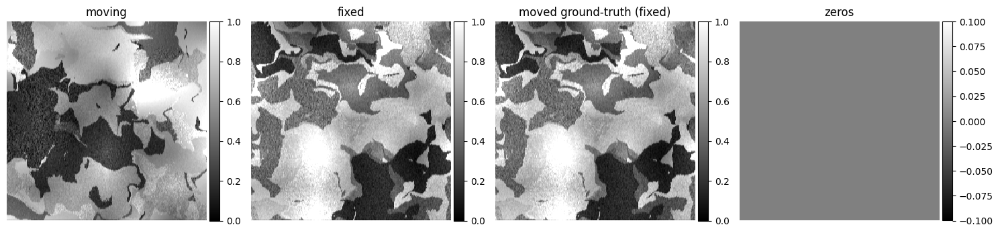

0epoch [00:00, ?epoch/s]

1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 1s - 510ms/epoch - 510ms/step
1/1 - 0s - 416ms/epoch - 416ms/step


2023-09-22 15:24:48.235713: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7f40c2fa67d0 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-09-22 15:24:48.235824: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Tesla V100-PCIE-32GB, Compute Capability 7.0
2023-09-22 15:24:48.235862: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (1): Tesla V100-PCIE-16GB, Compute Capability 7.0
2023-09-22 15:24:48.251681: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2023-09-22 15:24:48.729853: I ./tensorflow/compiler/jit/device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 200

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 197

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
1/1 - 0s - 373ms/epoch - 373ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 139/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 145/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
1/1 - 0s - 359ms/epoch - 359ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 229/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
1/1 - 0s - 389ms/epoch - 389ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 270/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 299/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 253ms/epoch - 253ms/step
Epoch 303/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 241ms/epoch - 241ms/step
Epoch 367/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 386/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 21

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 259ms/epoch - 259ms/step
Epoch 437/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 449/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 675/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
1/1 - 0s - 395ms/epoch - 395ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 777/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 231ms/epoch - 231ms/step
Epoch 801/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 843/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 887/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
1/1 - 0s - 357ms/epoch - 357ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 904/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 908/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 1

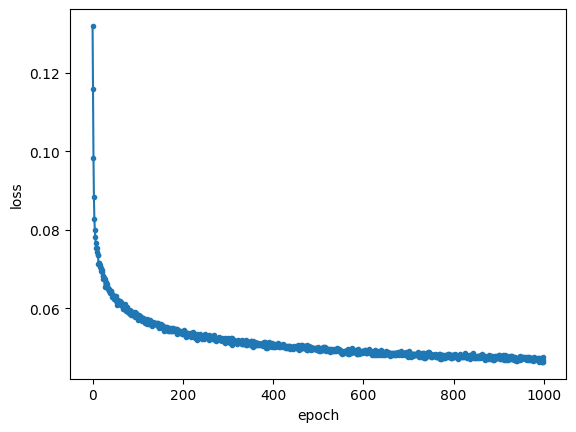

1/1 [==============================] - 0s 443ms/step


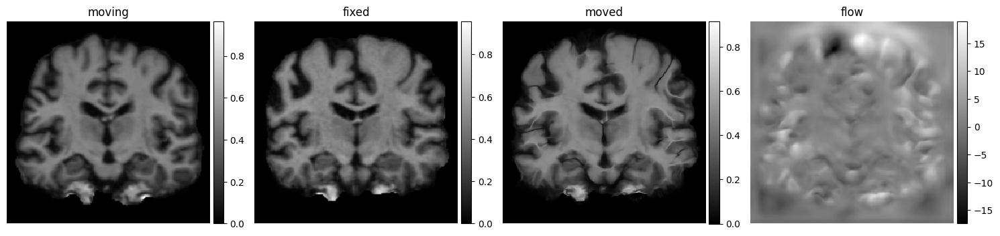

1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step


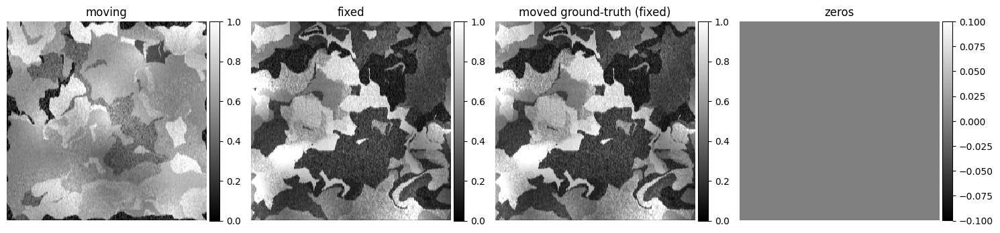

0epoch [00:00, ?epoch/s]

1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 378ms/epoch - 378ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 137

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 139/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 145/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 229/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 270/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
1/1 - 0s - 353ms/epoch - 353ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
1/1 - 0s - 345ms/epoch - 345ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

1/1 - 0s - 258ms/epoch - 258ms/step
Epoch 299/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 303/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
1/1 - 0s - 358ms/epoch - 358ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
1/1 - 0s - 362ms/epoch - 362ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
1/1 - 0s - 364ms/epoch - 364ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 367/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 386/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
1/1 - 0s - 356ms/epoch - 356ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
1/1 - 0s - 375ms/epoch - 375ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 437/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
1/1 - 0s - 351ms/epoch - 351ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 449/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
1/1 - 0s - 368ms/epoch - 368ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
1/1 - 0s - 376ms/epoch - 376ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
1/1 - 0s - 344ms/epoch - 344ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
1/1 - 0s - 347ms/epoch - 347ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
1/1 - 0s - 363ms/epoch - 363ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
1/1 - 0s - 348ms/epoch - 348ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
1/1 - 0s - 350ms/epoch - 350ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
1/1 - 0s - 367ms/epoch - 367ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 675/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
1/1 - 0s - 355ms/epoch - 355ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 777/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 801/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
1/1 - 0s - 342ms/epoch - 342ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 843/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 21

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 20

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
1/1 - 0s - 335ms/epoch - 335ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 887/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 904/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 908/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
1/1 - 0s - 352ms/epoch - 352ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
1/1 - 0s - 354ms/epoch - 354ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
1/1 - 0s - 361ms/epoch - 361ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 209ms/epoch - 209ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 1

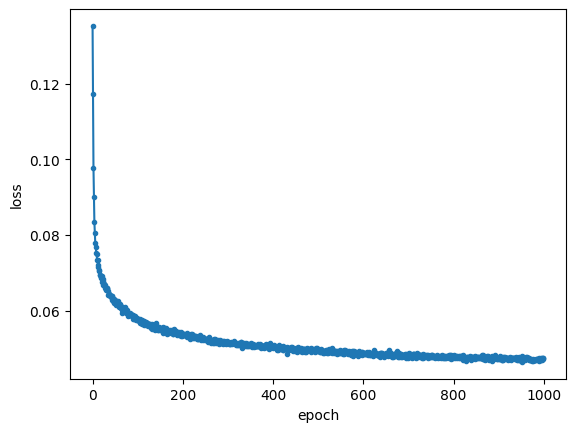

1/1 [==============================] - 1s 529ms/step


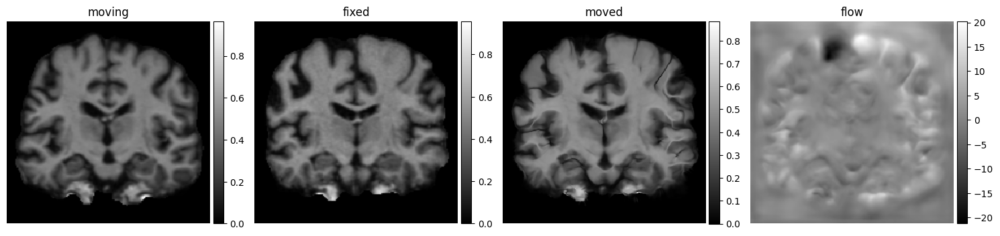

1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 166ms/epoch - 166ms/step


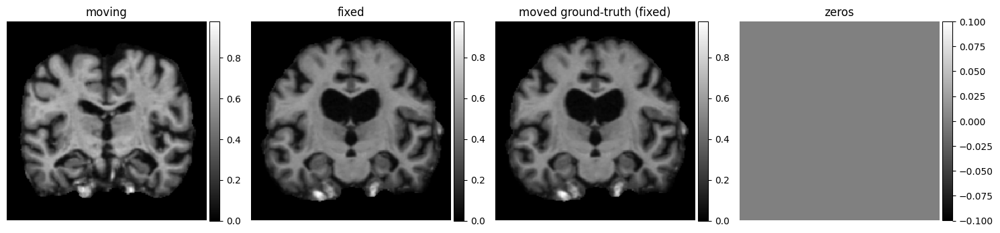

0epoch [00:00, ?epoch/s]

1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 180

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 349ms/epoch - 349ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 138

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 188

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 122ms/epoch - 122ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 93/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 94/1000
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 95/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 96/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 97/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 98/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 99/1000
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 100/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 101/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 102/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 103/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 104/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 105/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 106/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 107/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 108/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 109/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 110/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 111/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 112/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 113/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 114/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 115/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 116/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 117/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 118/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 119/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 120/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 121/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 122/1000
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 123/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 124/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 125/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 121ms/epoch - 121ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 126/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 127/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 128/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 129/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 130/1000
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 131/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 132/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 133/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 134/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 135/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 136/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 137/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 138/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 139/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 140/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 141/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 121ms/epoch - 121ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 142/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 143/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 144/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 145/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 146/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 147/1000
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 148/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 149/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 150/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 151/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 152/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 153/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 154/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 155/1000
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 156/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 157/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 158/1000
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 159/1000
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 160/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 161/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 162/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 163/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 164/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 165/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 166/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 167/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 168/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 169/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 170/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 171/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 172/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 173/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 174/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 175/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 176/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 177/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 178/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 179/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 180/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 181/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 182/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 183/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 184/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 185/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 186/1000
1/1 - 0s - 337ms/epoch - 337ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 187/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 188/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 189/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 190/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 191/1000
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 192/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 193/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 194/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 195/1000
1/1 - 0s - 340ms/epoch - 340ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 196/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 197/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 198/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 199/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 200/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 201/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 202/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 203/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 204/1000
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 205/1000
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 206/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 207/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 208/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 209/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 210/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 211/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 212/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 213/1000
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 214/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 215/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 216/1000
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 217/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 218/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 219/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 220/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 221/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 222/1000
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 223/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 224/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 225/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 226/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 227/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 228/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 229/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 230/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 231/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 232/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 233/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 234/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 235/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 236/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 237/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 238/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 239/1000
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 240/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 241/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 242/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 243/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 244/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 245/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 246/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 247/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 248/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 249/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 250/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 251/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 252/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 253/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 254/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 255/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 256/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 257/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 258/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 259/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 260/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 261/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 262/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 263/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 264/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 265/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 266/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 267/1000
1/1 - 0s - 369ms/epoch - 369ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 268/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 269/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 270/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 271/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 272/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 273/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 274/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 275/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 276/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 277/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 278/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 279/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 280/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 281/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 282/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 283/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 284/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 285/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 286/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 287/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 288/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 289/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 290/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 291/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 292/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 293/1000
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 294/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 295/1000
1/1 - 0s - 324ms/epoch - 324ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 296/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 297/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 298/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 299/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 300/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 301/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 302/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 303/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 304/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 305/1000
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 306/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 307/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 308/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 309/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 310/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 311/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 312/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 313/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 314/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 315/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 316/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 317/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 318/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 319/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 320/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 321/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 322/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 323/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 324/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 325/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 326/1000
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 327/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 328/1000
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 329/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 330/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 331/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 332/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 333/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 334/1000
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 335/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 336/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 337/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 338/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 339/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 340/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 341/1000
1/1 - 0s - 366ms/epoch - 366ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 342/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 343/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 344/1000
1/1 - 0s - 207ms/epoch - 207ms/step
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 345/1000
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 346/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 347/1000
1/1 - 0s - 333ms/epoch - 333ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 348/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 349/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 350/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 351/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 352/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 353/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 354/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 355/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 11

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 356/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 357/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 358/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 359/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 360/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 361/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 362/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 363/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 364/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 365/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 366/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 367/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 368/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 369/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 370/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 371/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 372/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 373/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 374/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 204ms/epoch - 204ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 375/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 376/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 377/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 378/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 379/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 380/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 381/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 19

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 382/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 383/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 384/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 385/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 386/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 387/1000
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 388/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 389/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 390/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 391/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 392/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 393/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 394/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 395/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 396/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 397/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 398/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 399/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 400/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 401/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 402/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 403/1000
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 404/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 405/1000
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 406/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 407/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 408/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 409/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 410/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 411/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 412/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 413/1000
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 414/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 415/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 416/1000
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 417/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 418/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 419/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 420/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 421/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 422/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 423/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 424/1000
1/1 - 0s - 341ms/epoch - 341ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 425/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 426/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 427/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 428/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 429/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 430/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 431/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 432/1000
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 433/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 434/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 435/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 436/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 437/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 438/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 439/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 440/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 441/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 442/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 443/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 444/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 445/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 446/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 447/1000
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 448/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 449/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 450/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 451/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 452/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 453/1000
1/1 - 0s - 321ms/epoch - 321ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 454/1000
1/1 - 0s - 216ms/epoch - 216ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 455/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 456/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 116ms/epoch - 116ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 457/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 458/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 459/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 460/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 461/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 462/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 463/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 464/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 465/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 466/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 467/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 468/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 469/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 470/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 471/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 472/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 473/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 474/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 475/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 476/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 477/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 478/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 479/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 480/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 481/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 482/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 483/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 484/1000
1/1 - 0s - 234ms/epoch - 234ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 485/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 486/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 487/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 488/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 489/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 490/1000
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 491/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 492/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 493/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 494/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 495/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 496/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 497/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 498/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 499/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 500/1000
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 501/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 502/1000
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 121ms/epoch - 121ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 503/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 504/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 505/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 506/1000
1/1 - 0s - 331ms/epoch - 331ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 507/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 508/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 509/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 510/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 511/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 512/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 513/1000
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 514/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 515/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 516/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 517/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 518/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 519/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 520/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 521/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 522/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 523/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 524/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 525/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 526/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 527/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 528/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 529/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 110ms/epoch - 110ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 530/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 531/1000
1/1 - 0s - 320ms/epoch - 320ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 532/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 122ms/epoch - 122ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 533/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 534/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 118ms/epoch - 118ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 535/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 536/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 537/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 538/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 539/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 540/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 541/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 542/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 543/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 544/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 545/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 546/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 547/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 548/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 549/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 550/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 551/1000
1/1 - 0s - 334ms/epoch - 334ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 552/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 553/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 554/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 555/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 556/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 557/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 558/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 559/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 560/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 561/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 562/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 563/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 564/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 565/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 566/1000
1/1 - 0s - 330ms/epoch - 330ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 567/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 568/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 569/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 570/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 571/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 572/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 573/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 574/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 575/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 576/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 577/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 578/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 579/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 580/1000
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 581/1000
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 582/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 583/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 584/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 585/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 586/1000
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 587/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 588/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 589/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 590/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 591/1000
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 592/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 593/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 594/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 595/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 596/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 597/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 598/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 599/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 600/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 601/1000
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 602/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 603/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 604/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 605/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 606/1000
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 607/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 608/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 609/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 610/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 611/1000
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 612/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 613/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 614/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 615/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 616/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 617/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 618/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 122ms/epoch - 122ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 619/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 620/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 621/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 622/1000
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 623/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 624/1000
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 625/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 626/1000
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 627/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 628/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 629/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 630/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 631/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 632/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 633/1000
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 634/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 635/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 636/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 637/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 638/1000
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 639/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 640/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 641/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 642/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 643/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 644/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 645/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 646/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 647/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 648/1000
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 203ms/epoch - 203ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 649/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 650/1000
1/1 - 0s - 336ms/epoch - 336ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 651/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 652/1000
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 653/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 654/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 655/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 656/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 657/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 658/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 659/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 660/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 661/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 662/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 663/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 664/1000
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 665/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 666/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 667/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 668/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 669/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 670/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 671/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 672/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 231ms/epoch - 231ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 673/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 674/1000
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 675/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 676/1000
1/1 - 0s - 328ms/epoch - 328ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 677/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 678/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 679/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 680/1000
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 681/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 682/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 683/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 684/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 685/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 686/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 687/1000
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 688/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 689/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 690/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 691/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 692/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 693/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 694/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 695/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 696/1000
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 697/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 698/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 699/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 118ms/epoch - 118ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 700/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 701/1000
1/1 - 0s - 313ms/epoch - 313ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 702/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 703/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 704/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 705/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 706/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 707/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 708/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 709/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 710/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 711/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 712/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 713/1000
1/1 - 0s - 235ms/epoch - 235ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 714/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 715/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 716/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 717/1000
1/1 - 0s - 329ms/epoch - 329ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 718/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 719/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 720/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 721/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 722/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 723/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 724/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 725/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 726/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 727/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 728/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 729/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 730/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 731/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 732/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 733/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 734/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 735/1000
1/1 - 0s - 315ms/epoch - 315ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 736/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 737/1000
1/1 - 0s - 228ms/epoch - 228ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 738/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 739/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 740/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 741/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 742/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 743/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 744/1000
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 745/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 746/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 747/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 748/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 749/1000
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 213ms/epoch - 213ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 750/1000
1/1 - 0s - 339ms/epoch - 339ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 751/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 752/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 753/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 754/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 755/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 224ms/epoch - 224ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 756/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 757/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 758/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 759/1000
1/1 - 0s - 318ms/epoch - 318ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 760/1000
1/1 - 0s - 306ms/epoch - 306ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 761/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 762/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 763/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 764/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 765/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 766/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 767/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 768/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 769/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 770/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 771/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 772/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 773/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 774/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 775/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 776/1000
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 777/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 778/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 779/1000
1/1 - 0s - 338ms/epoch - 338ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 780/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 781/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 782/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 783/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 784/1000
1/1 - 0s - 246ms/epoch - 246ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 785/1000
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 786/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 787/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 788/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 789/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 790/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 791/1000
1/1 - 0s - 308ms/epoch - 308ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 792/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 793/1000
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 794/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 795/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 796/1000
1/1 - 0s - 227ms/epoch - 227ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 797/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 798/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 799/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 200ms/epoch - 200ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 800/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 801/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 802/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 803/1000
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 804/1000
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 12

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 805/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 806/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 807/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 808/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 809/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 810/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 811/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 812/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 239ms/epoch - 239ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 813/1000
1/1 - 0s - 242ms/epoch - 242ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 814/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 815/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 816/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 817/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 818/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 819/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 820/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 821/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 822/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 823/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 824/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 825/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 826/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 827/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 828/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 829/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 830/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 831/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 832/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 833/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 834/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 835/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 836/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 837/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 838/1000
1/1 - 0s - 312ms/epoch - 312ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 839/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 840/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 841/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 842/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 843/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 844/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 845/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 846/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 847/1000
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 848/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 849/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 850/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 851/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 852/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 853/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 854/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 855/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 856/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 857/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 858/1000
1/1 - 0s - 322ms/epoch - 322ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 859/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 860/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 861/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 233ms/epoch - 233ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 862/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 863/1000
1/1 - 0s - 217ms/epoch - 217ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 864/1000
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 865/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 866/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 867/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 868/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 869/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 870/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 871/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 872/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 873/1000
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 874/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 875/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 196ms/epoch - 196ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 876/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 877/1000
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 878/1000
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 879/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 880/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 881/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 882/1000
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 883/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 884/1000
1/1 - 0s - 237ms/epoch - 237ms/step
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 885/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 886/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 887/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 888/1000
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 202ms/epoch - 202ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 889/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 11

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 890/1000
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 891/1000
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 191ms/epoch - 191ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 892/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 893/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 894/1000
1/1 - 0s - 319ms/epoch - 319ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 895/1000
1/1 - 0s - 346ms/epoch - 346ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 192ms/epoch - 192ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 896/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 897/1000
1/1 - 0s - 317ms/epoch - 317ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 898/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 899/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 201ms/epoch - 201ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 900/1000
1/1 - 0s - 309ms/epoch - 309ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 901/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 902/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 903/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 904/1000
1/1 - 0s - 332ms/epoch - 332ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 905/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 906/1000
1/1 - 0s - 294ms/epoch - 294ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 907/1000
1/1 - 0s - 325ms/epoch - 325ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 908/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 909/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 910/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 911/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 912/1000
1/1 - 0s - 251ms/epoch - 251ms/step
1/1 - 0s - 194ms/epoch - 194ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 913/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 914/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 915/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 916/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 917/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 918/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 919/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 920/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 921/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 922/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 923/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 924/1000
1/1 - 0s - 314ms/epoch - 314ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 925/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 926/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 927/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 928/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 929/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 253ms/epoch - 253ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 930/1000
1/1 - 0s - 272ms/epoch - 272ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 931/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 932/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 933/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 934/1000
1/1 - 0s - 218ms/epoch - 218ms/step
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 935/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 936/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 937/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 938/1000
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 939/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 940/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 941/1000
1/1 - 0s - 323ms/epoch - 323ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 18

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 942/1000
1/1 - 0s - 282ms/epoch - 282ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 943/1000
1/1 - 0s - 310ms/epoch - 310ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 944/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 945/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 946/1000
1/1 - 0s - 219ms/epoch - 219ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 947/1000
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 948/1000
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 949/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 950/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 951/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 952/1000
1/1 - 0s - 326ms/epoch - 326ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 953/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 954/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 955/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 956/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 957/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 958/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 211ms/epoch - 211ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 959/1000
1/1 - 0s - 236ms/epoch - 236ms/step
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 960/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 961/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 962/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 963/1000
1/1 - 0s - 316ms/epoch - 316ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 964/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 965/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 966/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 252ms/epoch - 252ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 967/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 968/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 969/1000
1/1 - 0s - 212ms/epoch - 212ms/step
1/1 - 0s - 278ms/epoch - 278ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 970/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 971/1000
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 241ms/epoch - 241ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 972/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 973/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 974/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 975/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 976/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 977/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 978/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 979/1000
1/1 - 0s - 266ms/epoch - 266ms/step
1/1 - 0s - 198ms/epoch - 198ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 980/1000
1/1 - 0s - 258ms/epoch - 258ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 981/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 982/1000
1/1 - 0s - 289ms/epoch - 289ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 115ms/epoch - 115ms/step
1/1 - 0s - 121ms/epoch - 121ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 983/1000
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 984/1000
1/1 - 0s - 307ms/epoch - 307ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 122ms/epoch - 122ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 985/1000
1/1 - 0s - 261ms/epoch - 261ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 986/1000
1/1 - 0s - 305ms/epoch - 305ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 987/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 988/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 989/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 990/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 991/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 992/1000
1/1 - 0s - 297ms/epoch - 297ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 13

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 993/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 17

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 994/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 995/1000
1/1 - 0s - 189ms/epoch - 189ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 996/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 997/1000
1/1 - 0s - 245ms/epoch - 245ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 16

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 998/1000
1/1 - 0s - 287ms/epoch - 287ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 14

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 999/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 15

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1000/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 1

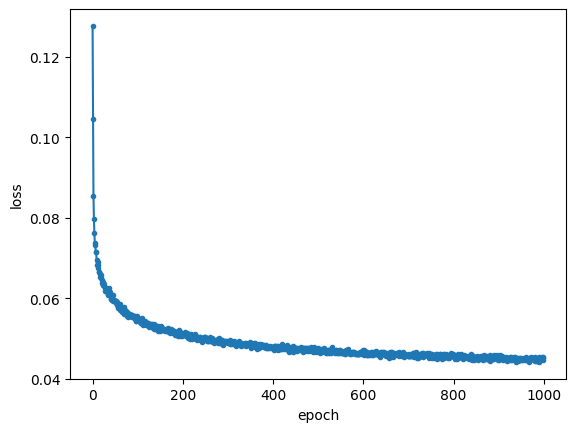

1/1 [==============================] - 1s 556ms/step


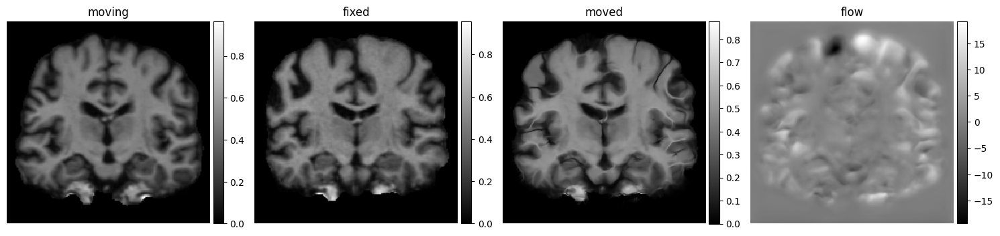

1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 192ms/epoch - 192ms/step


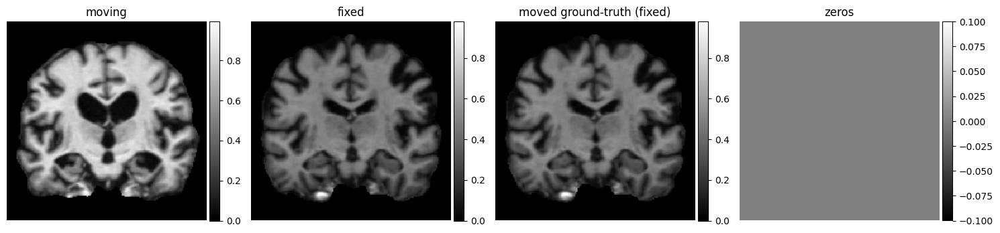

0epoch [00:00, ?epoch/s]

1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step


  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 1/1000
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 2/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 3/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 120ms/epoch - 120ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 129m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 4/1000
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 5/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 132m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 6/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 143m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 7/1000
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 259ms/epoch - 259ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 8/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 9/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 139m

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 10/1000
1/1 - 0s - 256ms/epoch - 256ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 11/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 12/1000
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 147

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 13/1000
1/1 - 0s - 230ms/epoch - 230ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 14/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 15/1000
1/1 - 0s - 298ms/epoch - 298ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 16/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 17/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 18/1000
1/1 - 0s - 275ms/epoch - 275ms/step
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 19/1000
1/1 - 0s - 279ms/epoch - 279ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 20/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 21/1000
1/1 - 0s - 283ms/epoch - 283ms/step
1/1 - 0s - 220ms/epoch - 220ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 22/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 132

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 23/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 134

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 24/1000
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 119ms/epoch - 119ms/step
1/1 - 0s - 133

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 25/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 190ms/epoch - 190ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 26/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 27/1000
1/1 - 0s - 262ms/epoch - 262ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 151

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 28/1000
1/1 - 0s - 221ms/epoch - 221ms/step
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 182ms/epoch - 182ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 29/1000
1/1 - 0s - 327ms/epoch - 327ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 30/1000
1/1 - 0s - 299ms/epoch - 299ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 31/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 32/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 33/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 193ms/epoch - 193ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 34/1000
1/1 - 0s - 222ms/epoch - 222ms/step
1/1 - 0s - 215ms/epoch - 215ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 35/1000
1/1 - 0s - 301ms/epoch - 301ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 36/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 37/1000
1/1 - 0s - 206ms/epoch - 206ms/step
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 186ms/epoch - 186ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 113ms/epoch - 113ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 38/1000
1/1 - 0s - 260ms/epoch - 260ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 185ms/epoch - 185ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 39/1000
1/1 - 0s - 300ms/epoch - 300ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 40/1000
1/1 - 0s - 250ms/epoch - 250ms/step
1/1 - 0s - 244ms/epoch - 244ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 147

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 41/1000
1/1 - 0s - 273ms/epoch - 273ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 42/1000
1/1 - 0s - 292ms/epoch - 292ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 117ms/epoch - 117ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 122ms/epoch - 122ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 43/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 44/1000
1/1 - 0s - 226ms/epoch - 226ms/step
1/1 - 0s - 205ms/epoch - 205ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 45/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 46/1000
1/1 - 0s - 267ms/epoch - 267ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 47/1000
1/1 - 0s - 274ms/epoch - 274ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 48/1000
1/1 - 0s - 311ms/epoch - 311ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 49/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 50/1000
1/1 - 0s - 276ms/epoch - 276ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 129

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 51/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 52/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 53/1000
1/1 - 0s - 271ms/epoch - 271ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 153

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 54/1000
1/1 - 0s - 240ms/epoch - 240ms/step
1/1 - 0s - 238ms/epoch - 238ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 130

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 55/1000
1/1 - 0s - 197ms/epoch - 197ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 153

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 56/1000
1/1 - 0s - 232ms/epoch - 232ms/step
1/1 - 0s - 249ms/epoch - 249ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 57/1000
1/1 - 0s - 281ms/epoch - 281ms/step
1/1 - 0s - 210ms/epoch - 210ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 136

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 58/1000
1/1 - 0s - 269ms/epoch - 269ms/step
1/1 - 0s - 188ms/epoch - 188ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 143

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 59/1000
1/1 - 0s - 247ms/epoch - 247ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 60/1000
1/1 - 0s - 268ms/epoch - 268ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 121ms/epoch - 121ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 161

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 61/1000
1/1 - 0s - 290ms/epoch - 290ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 168

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 62/1000
1/1 - 0s - 343ms/epoch - 343ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 156

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 63/1000
1/1 - 0s - 208ms/epoch - 208ms/step
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 64/1000
1/1 - 0s - 264ms/epoch - 264ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 122ms/epoch - 122ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 134

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 65/1000
1/1 - 0s - 285ms/epoch - 285ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 66/1000
1/1 - 0s - 304ms/epoch - 304ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 164

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 67/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 148

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 68/1000
1/1 - 0s - 280ms/epoch - 280ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 151

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 69/1000
1/1 - 0s - 295ms/epoch - 295ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 145

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 70/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 167

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 71/1000
1/1 - 0s - 296ms/epoch - 296ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 184ms/epoch - 184ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 152

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 72/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 130ms/epoch - 130ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 73/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 225ms/epoch - 225ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 154

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 74/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 75/1000
1/1 - 0s - 286ms/epoch - 286ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 76/1000
1/1 - 0s - 255ms/epoch - 255ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 138

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 77/1000
1/1 - 0s - 265ms/epoch - 265ms/step
1/1 - 0s - 195ms/epoch - 195ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 159

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 78/1000
1/1 - 0s - 302ms/epoch - 302ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 79/1000
1/1 - 0s - 248ms/epoch - 248ms/step
1/1 - 0s - 243ms/epoch - 243ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 125ms/epoch - 125ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 146

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 80/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 183ms/epoch - 183ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 147

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 81/1000
1/1 - 0s - 263ms/epoch - 263ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 174ms/epoch - 174ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 82/1000
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 214ms/epoch - 214ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 109ms/epoch - 109ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 114ms/epoch - 114ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 157

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 83/1000
1/1 - 0s - 293ms/epoch - 293ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 178ms/epoch - 178ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 131ms/epoch - 131ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 133

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 84/1000
1/1 - 0s - 270ms/epoch - 270ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 130

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 85/1000
1/1 - 0s - 291ms/epoch - 291ms/step
1/1 - 0s - 180ms/epoch - 180ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 118ms/epoch - 118ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 126ms/epoch - 126ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 132ms/epoch - 132ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 127ms/epoch - 127ms/step
1/1 - 0s - 135ms/epoch - 135ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 123ms/epoch - 123ms/step
1/1 - 0s - 128ms/epoch - 128ms/step
1/1 - 0s - 136ms/epoch - 136ms/step
1/1 - 0s - 129ms/epoch - 129ms/step
1/1 - 0s - 124ms/epoch - 124ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 143

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 86/1000
1/1 - 0s - 229ms/epoch - 229ms/step
1/1 - 0s - 223ms/epoch - 223ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 134ms/epoch - 134ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 140ms/epoch - 140ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 142

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 87/1000
1/1 - 0s - 284ms/epoch - 284ms/step
1/1 - 0s - 181ms/epoch - 181ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 145ms/epoch - 145ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 179ms/epoch - 179ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 166

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 88/1000
1/1 - 0s - 254ms/epoch - 254ms/step
1/1 - 0s - 199ms/epoch - 199ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 144ms/epoch - 144ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 89/1000
1/1 - 0s - 303ms/epoch - 303ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 187ms/epoch - 187ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 177ms/epoch - 177ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 159

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 90/1000
1/1 - 0s - 277ms/epoch - 277ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 139ms/epoch - 139ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 137ms/epoch - 137ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 150ms/epoch - 150ms/step
1/1 - 0s - 143ms/epoch - 143ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 145

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 91/1000
1/1 - 0s - 288ms/epoch - 288ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 170ms/epoch - 170ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 158ms/epoch - 158ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 142ms/epoch - 142ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 138ms/epoch - 138ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 155ms/epoch - 155ms/step
1/1 - 0s - 147ms/epoch - 147ms/step
1/1 - 0s - 151ms/epoch - 151ms/step
1/1 - 0s - 172ms/epoch - 172ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 160ms/epoch - 160ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 165ms/epoch - 165ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 154ms/epoch - 154ms/step
1/1 - 0s - 141ms/epoch - 141ms/step
1/1 - 0s - 152

  0%|          | 0.00/100 [00:00<?, ?batch/s]

Epoch 92/1000
1/1 - 0s - 257ms/epoch - 257ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 152ms/epoch - 152ms/step
1/1 - 0s - 133ms/epoch - 133ms/step
1/1 - 0s - 146ms/epoch - 146ms/step
1/1 - 0s - 149ms/epoch - 149ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 157ms/epoch - 157ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 153ms/epoch - 153ms/step
1/1 - 0s - 167ms/epoch - 167ms/step
1/1 - 0s - 162ms/epoch - 162ms/step
1/1 - 0s - 169ms/epoch - 169ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 168ms/epoch - 168ms/step
1/1 - 0s - 175ms/epoch - 175ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 163ms/epoch - 163ms/step
1/1 - 0s - 173ms/epoch - 173ms/step
1/1 - 0s - 156ms/epoch - 156ms/step
1/1 - 0s - 164ms/epoch - 164ms/step
1/1 - 0s - 159ms/epoch - 159ms/step
1/1 - 0s - 171ms/epoch - 171ms/step
1/1 - 0s - 176ms/epoch - 176ms/step
1/1 - 0s - 148ms/epoch - 148ms/step
1/1 - 0s - 161ms/epoch - 161ms/step
1/1 - 0s - 166ms/epoch - 166ms/step
1/1 - 0s - 159

In [ ]:
for k in range(0, 100, 5):
    exec(f'Hybr_{k} = VxmTest()')
    exec(f'hybrid_generator_{k} = vxm_data_generator_hybrid(real_train, label_maps_synth, SynthIm.label_to_image, alpha_real=k/100, batch_size=batch_size)')
    exec(f'Hybr_{k}.CNNvxm(train_gen=hybrid_generator_{k}, val_generator=val_generator)')
    exec(f'Hybr_{k}.train(total_epo = train_no)')
    exec(f'Hybr_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
    led = 'loss'
    led1 = 'val_loss' 
    exec(f'b = Hybr_{k}.hist.history[led]')
    exec(f'a = Hybr_{k}.hist.history[led1]')
    exec(f'df = pd.DataFrame(b)')
    exec(f'df1 = pd.DataFrame(a)')
    exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
    exec(f'loc1 = csv_loc+val_loss+str({k})+goblin_csv')
    exec(f'df.to_csv(loc, index=False, header=False)')
    exec(f'df1.to_csv(loc1, index=False, header=False)')

    # for i in range(no_of_rounds-1):
    #     exec(f'Hybr_{k}.vxm_model.load_weights(model_loc+name+str({k})+goblin)')
    #     exec(f'Hybr_{k}.train(total_epo = train_no)')
    #     exec(f'Hybr_{k}.vxm_model.save_weights(model_loc+name+str({k})+goblin)')
    #     led = 'loss'
    #     exec(f'b = Hybr_{k}.hist.history[led]')
    #     exec(f'df = pd.DataFrame(b)')
    #     exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
    #     exec(f'df.to_csv(loc, mode = mode_csv, index=False, header=False)')
    exec(f'hybr_{k} = Hybr_{k}.RegPred(val_input)[1]')

In [ ]:
for k in range(0, 100, 5):
    exec(f'loc = csv_loc+name_loss+str({k})+goblin_csv')
    exec(f'plot_csv(loc)')

In [ ]:
for k in range(0, 100, 5):
    exec(f'loc = csv_loc+val_loss+str({k})+goblin_csv')
    exec(f'plot_csv(loc)')

In [ ]:
# real = Real.RegPred(val_input)[1]
# synth = Synth.RegPred(val_input)[1]

In [ ]:
# ne.plot.flow([real[1].squeeze()[::3,::3]], width=5);
# ne.plot.flow([synth[1].squeeze()[::3,::3]], width=5);

In [ ]:
for k in range(0, 100, 5):
    exec(f'ne.plot.flow([hybr_{k}[1].squeeze()],titles=k, width=5);')

In [ ]:
# for k in range(5, 15, 5):
#     exec(f'ne.plot.flow([fshot_{k}[0].squeeze()[::3, ::3]],titles=k, width=5);')

In [ ]:
# for k in range(5, 15, 5):
#     exec(f'ne.plot.flow([Hybrid_fshot_{k}[0].squeeze()[::3, ::3]],titles=k, width=5);')